In [1]:

import sys
import os
import pathlib
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
# path = "C:/Users/opolezh/Desktop/Paris Saclay/Thèse/2_SCRIPT/path"


In [2]:
# stim_csv =  sorted(str(p) for p in pathlib.Path("C:/Users/opolezh/Desktop/Paris Saclay/Thèse/2_SCRIPT/path").glob("*.csv"))

stim_csv =  sorted(str(p) for p in pathlib.Path("C:/Users/opolezh/Desktop/Paris Saclay/These/6_Github/3_Path/path_raw").glob("*.csv"))
stim_csv 

['C:\\Users\\opolezh\\Desktop\\Paris Saclay\\These\\6_Github\\3_Path\\path_raw\\iid_left_left_150.csv',
 'C:\\Users\\opolezh\\Desktop\\Paris Saclay\\These\\6_Github\\3_Path\\path_raw\\iid_left_right_150.csv',
 'C:\\Users\\opolezh\\Desktop\\Paris Saclay\\These\\6_Github\\3_Path\\path_raw\\iid_right_left_150.csv',
 'C:\\Users\\opolezh\\Desktop\\Paris Saclay\\These\\6_Github\\3_Path\\path_raw\\iid_right_right_150.csv',
 'C:\\Users\\opolezh\\Desktop\\Paris Saclay\\These\\6_Github\\3_Path\\path_raw\\rdw_left_left_150.csv',
 'C:\\Users\\opolezh\\Desktop\\Paris Saclay\\These\\6_Github\\3_Path\\path_raw\\rdw_left_right_150.csv',
 'C:\\Users\\opolezh\\Desktop\\Paris Saclay\\These\\6_Github\\3_Path\\path_raw\\rdw_right_left_150.csv',
 'C:\\Users\\opolezh\\Desktop\\Paris Saclay\\These\\6_Github\\3_Path\\path_raw\\rdw_right_right_150.csv']

In [3]:
iid_left_left = pd.read_csv(stim_csv [0], header=None).to_numpy()
rdw_left_left = pd.read_csv(stim_csv [4], header=None).to_numpy()

In [4]:
iid_left_right = pd.read_csv(stim_csv [1], header=None).to_numpy()
rdw_left_right = pd.read_csv(stim_csv [5], header=None).to_numpy()

In [5]:
iid_right_left = pd.read_csv(stim_csv [2], header=None).to_numpy()
rdw_right_left = pd.read_csv(stim_csv [6], header=None).to_numpy()

In [6]:
iid_right_right = pd.read_csv(stim_csv [3], header=None).to_numpy()
rdw_right_right = pd.read_csv(stim_csv [7], header=None).to_numpy()

In [ ]:
# # search the number of visible points
# def search_f(path):
#     dif = []
#     for k in range(1,int(len(path)*0.4)+1): # 30 % of trajectory 200*0.3=  max njmbre of missing points = 40 pts
#         sd = round(np.std(path[0:-k]),3) # sd for point visible 
#         sd_kstep = round(np.sqrt(k),3) # nombre the point to predicted sqrt(k)
#         dif.append(round(abs(sd_kstep-sd),3))
#     mi = np.min(dif)
#     f = dif.index(mi) # missing positions index
#     return f

In [7]:
# search the number of visible points
def search_f(path):
    dif = []
    for k in range(1,int(len(path)*0.4)+1): # 30 % of trajectory 200*0.3=  max njmbre of missing points = 40 pts
        sd = round(np.std(path[0:-k]),4) # sd for point visible 
        sd_kstep = round(np.sqrt(k),4) # nombre the point to predicted sqrt(k)
        dif.append(round(abs(sd_kstep-sd),4))
    mi = np.min(dif)
    f = dif.index(mi) # missing positions index
    return f

In [10]:
# path = rdw_left_left_save
# name = 'rdw_left_left'
def check_stimul (path_rdw,path_iid, name):
    f_all  = []
    for k in range(50):

        fig = plt.figure(figsize=(15,15))
        plt.subplot(2, 2, 1)
        f= search_f(path_rdw[:,k])
        f_all.append(f+1)
        plt.plot(path_rdw[:-(f+1),k] ,range(path_rdw.shape[0]-(f+1)),'o-',)
        plt.plot(path_rdw[-(f+1),k],path_rdw.shape[0]-f, marker='o',color='r',label=f'last visibl' )
        plt.title(f' {name} rdw (mu: {round(np.mean(path_rdw[0:-(f+1),k]),3)}, σ: {round(np.std(path_rdw[0:-(f+1),k]),3)}, n_to_extr={f+1})',
                      fontname="Times New Roman", fontsize=20)
    #     plt.title(f'f; {f+1} {rdw_left_left_save[-(f+1),k]}')
        plt.legend(fontsize=15,loc='upper right')
        plt.xlabel('X position [deg]', fontname="Times New Roman",fontsize=20)
        plt.ylabel('frame',fontname="Times New Roman",fontsize=20)
        plt.gca().invert_yaxis()
        plt.tick_params(axis='both', which='major', labelsize=15)
        plt.xlim(-20,20)
        plt.ylim(160,-1)
        
        plt.subplot(2, 2, 2)
        plt.plot(path_iid[:-(f+1),k] ,range(path_iid.shape[0]-(f+1)),'o-',)
        plt.plot(path_iid[-(f+1),k],path_iid.shape[0]-f, marker='o',color='r',label=f'last visibl' )
        plt.title(f' {name} iid (mu: {round(np.mean(path_iid[0:-(f+1),k]),3)}, σ: {round(np.std(path_iid[0:-(f+1),k]),3)}, n_to_extr={f+1})',
                      fontname="Times New Roman", fontsize=20)
    #     plt.title(f'f; {f+1} {rdw_left_left_save[-(f+1),k]}')
        plt.legend(fontsize=15,loc='upper right')
        plt.xlabel('X position [deg]', fontname="Times New Roman",fontsize=20)
        plt.ylabel('frame',fontname="Times New Roman",fontsize=20)
        plt.gca().invert_yaxis()
        plt.tick_params(axis='both', which='major', labelsize=15)
        plt.xlim(-20,20)
        plt.ylim(160,-1)
        
#         
#         plt.savefig(f'{name}_{k}.png',bbox_inches = 'tight')
    return f_all

C:\Users\opolezh\AppData\Local\Temp\ipykernel_6340\2464156862.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(15,15))


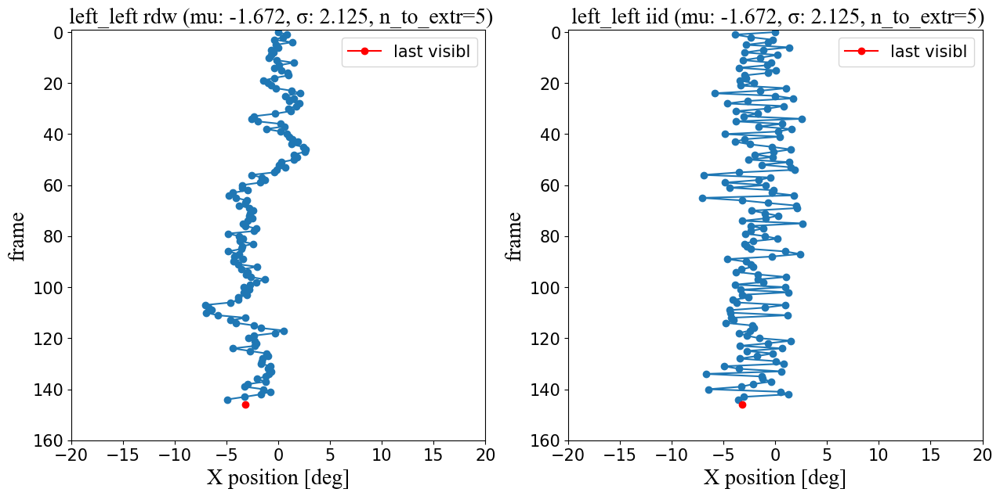

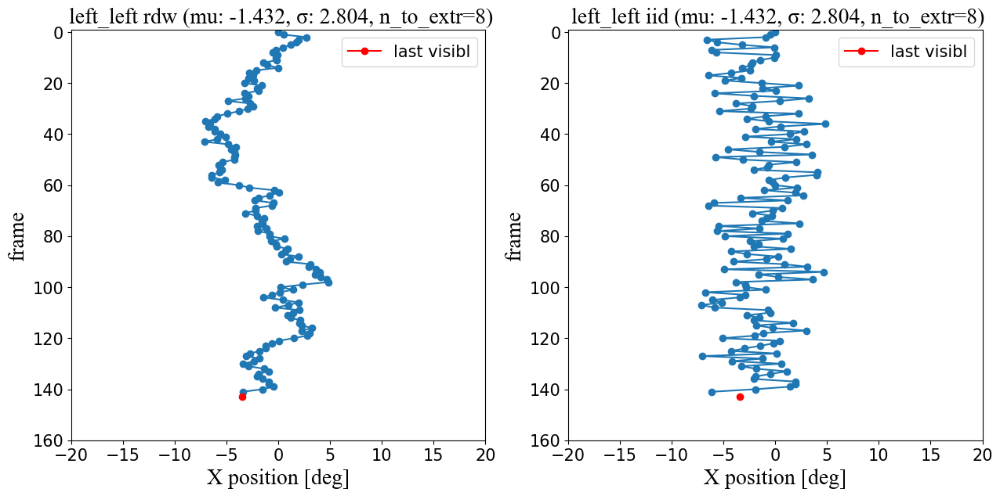

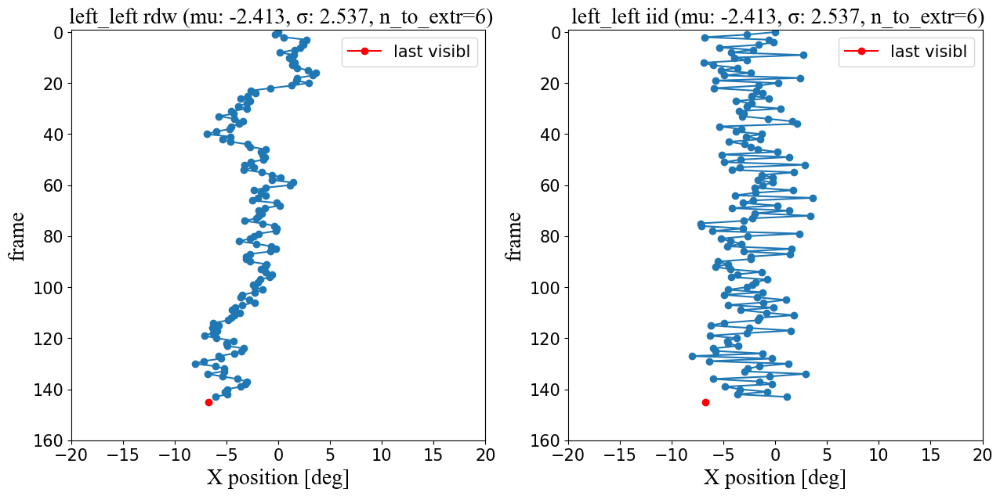

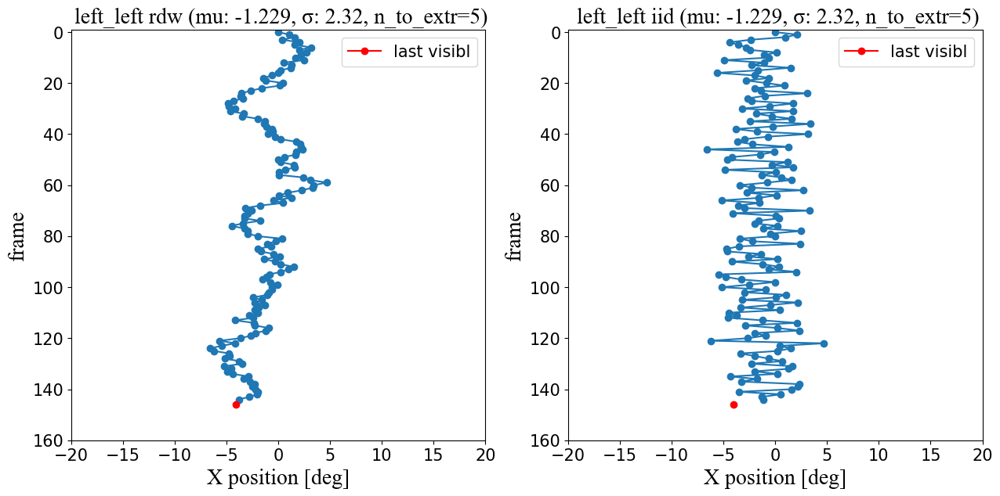

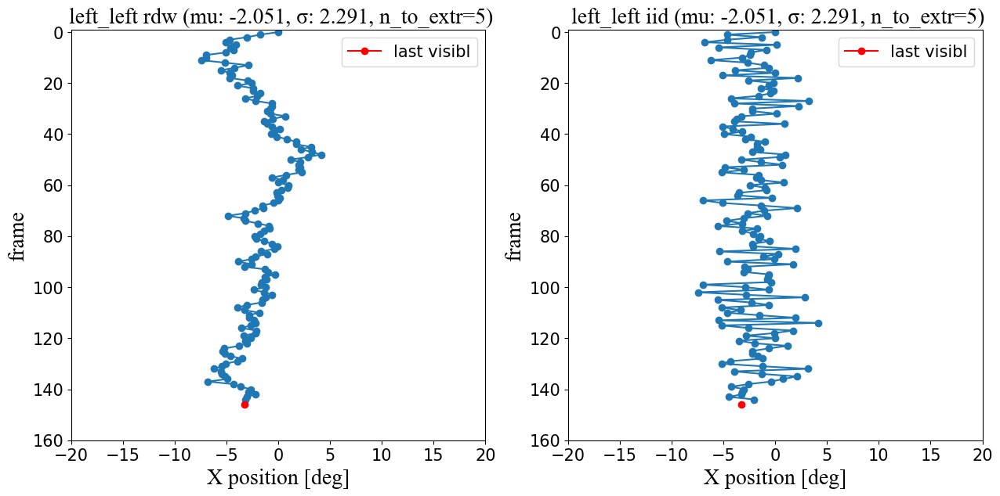

...

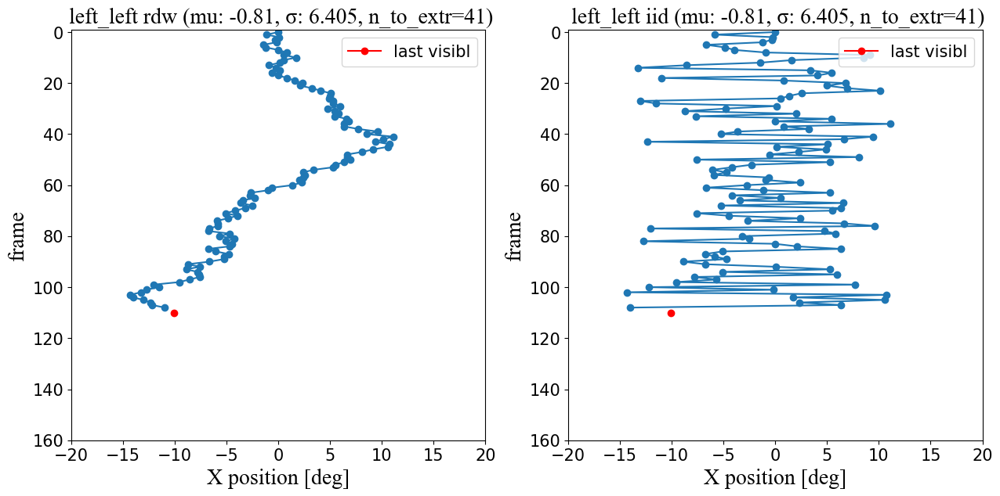

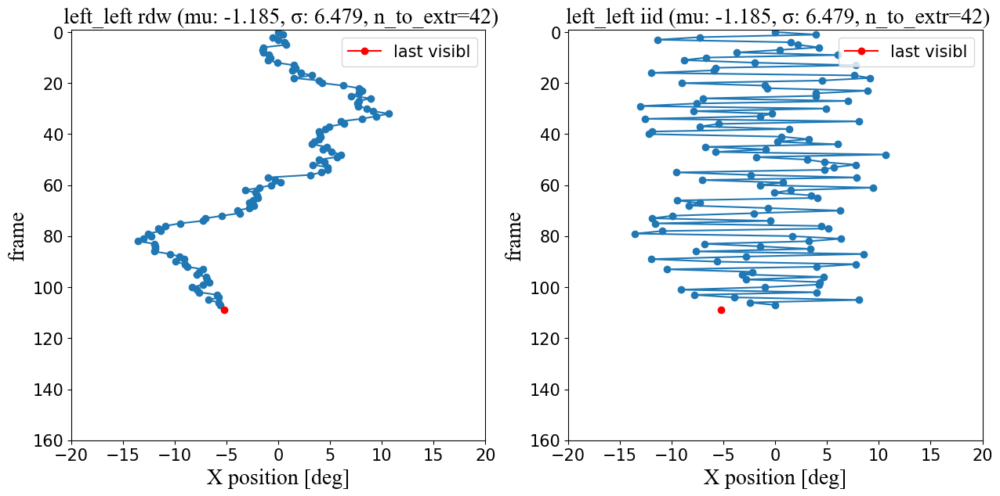

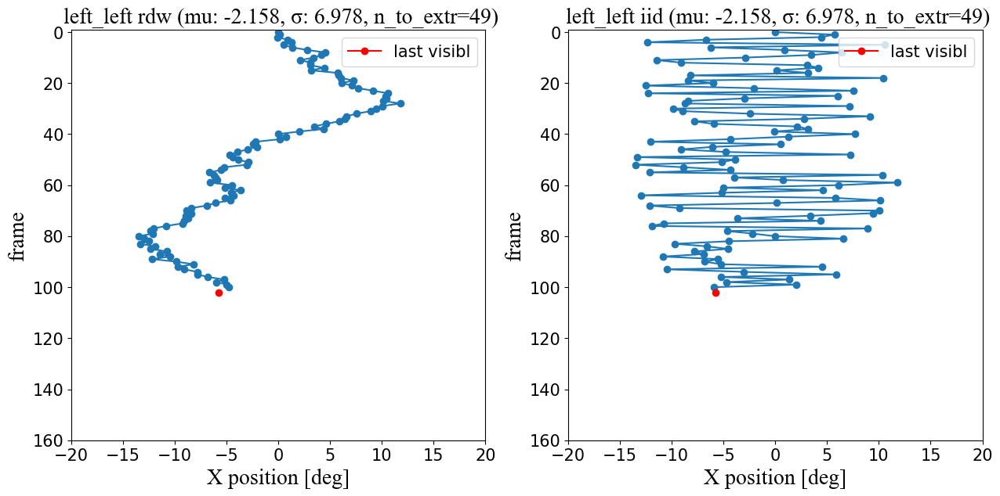

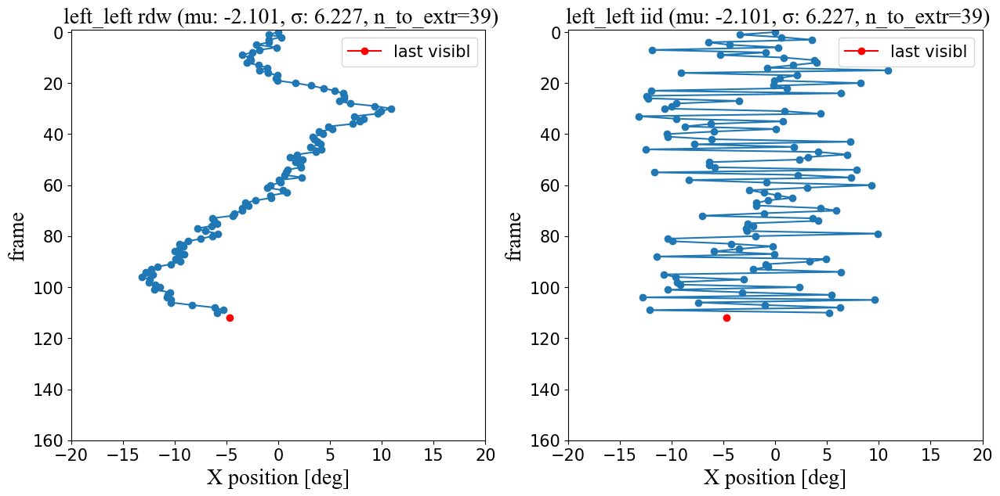

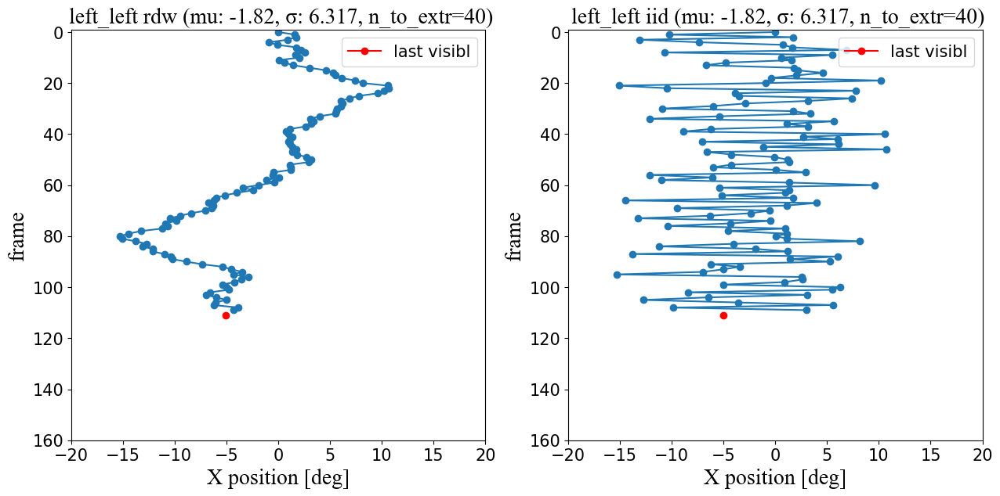

In [11]:
f_ll= check_stimul(rdw_left_left,iid_left_left,'left_left')

C:\Users\opolezh\AppData\Local\Temp\ipykernel_6340\2464156862.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(15,15))


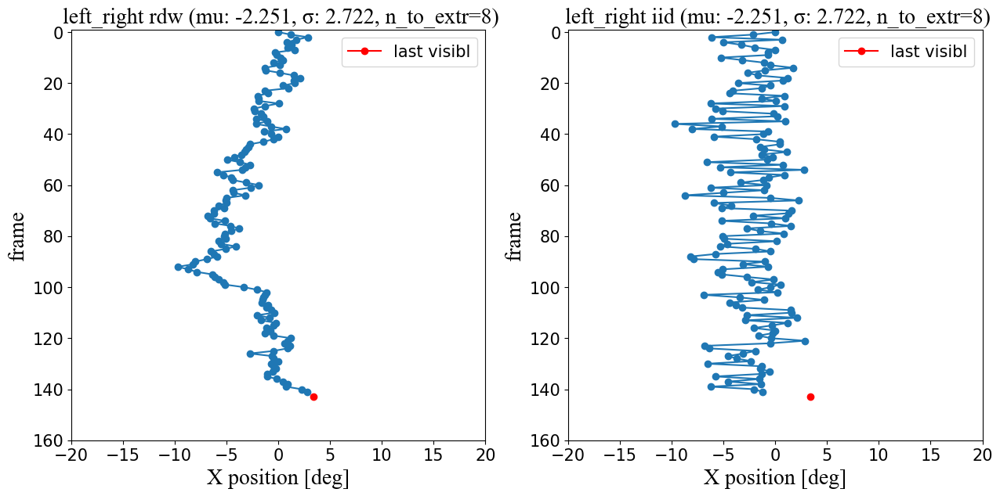

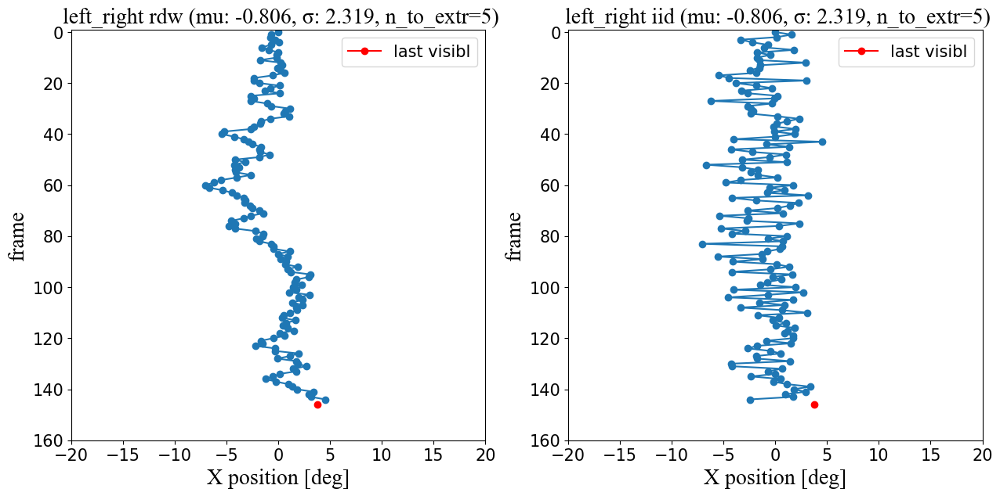

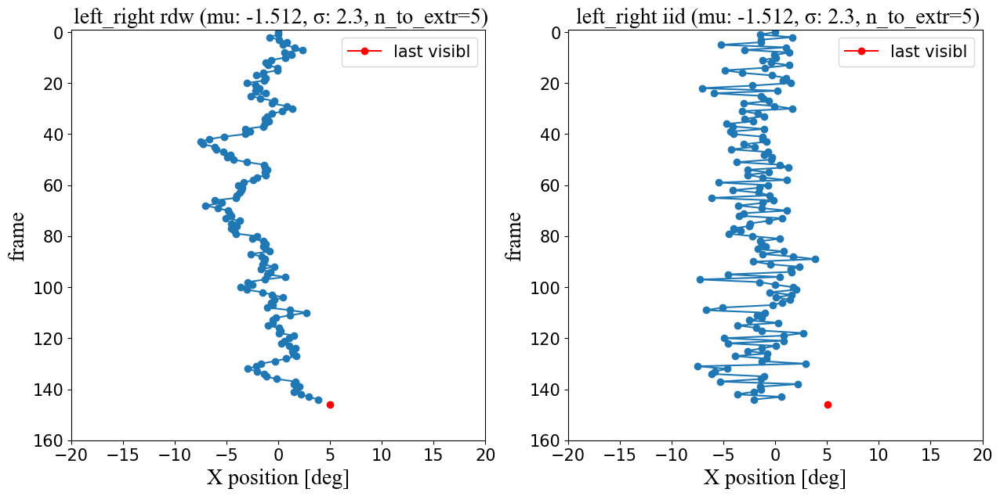

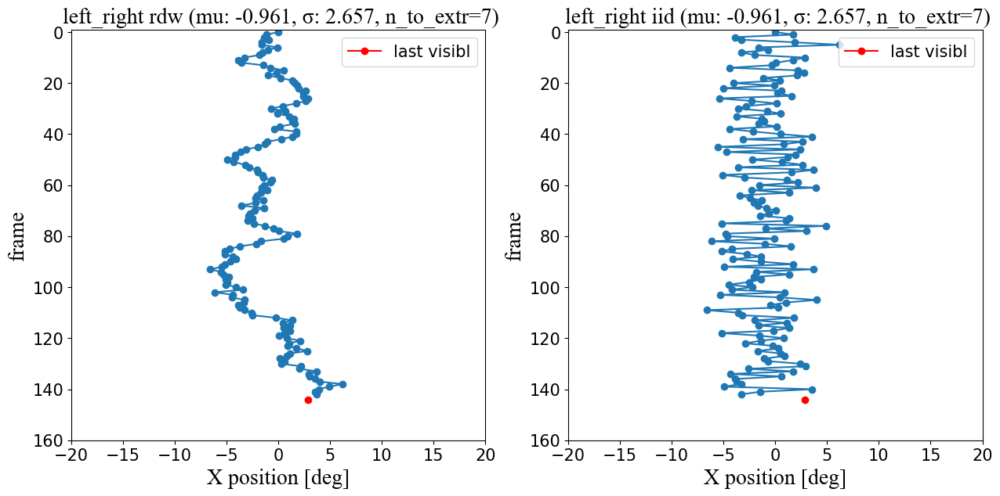

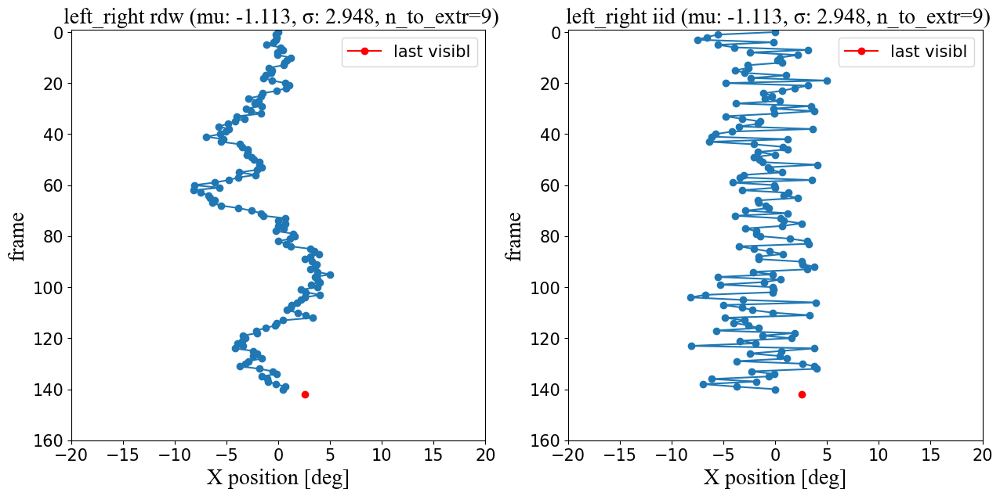

...

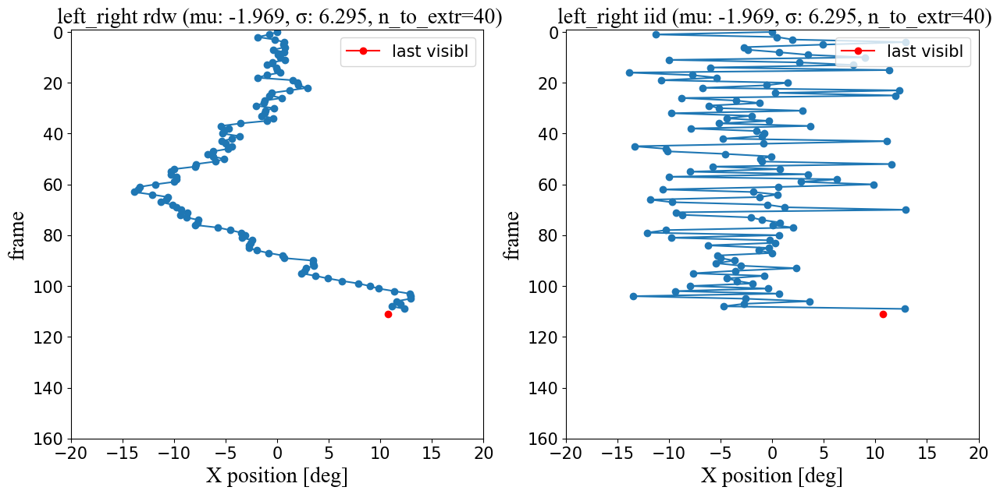

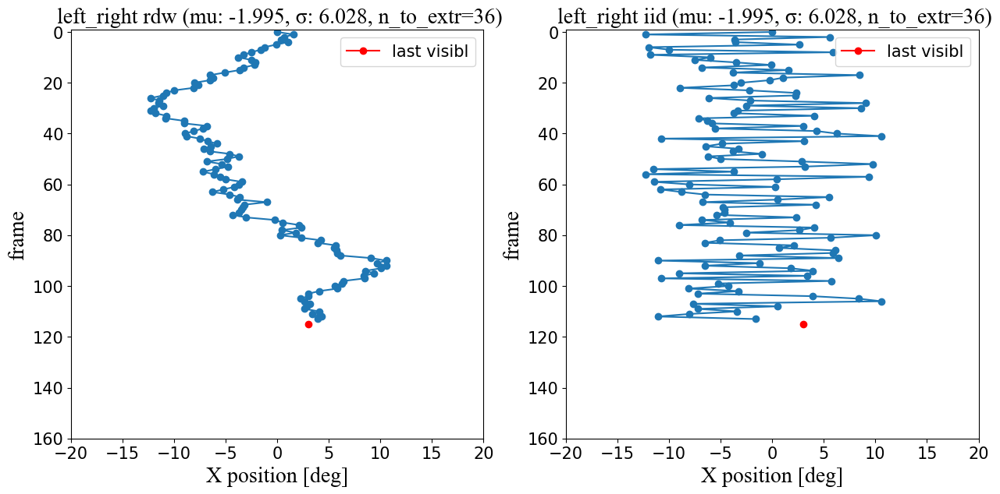

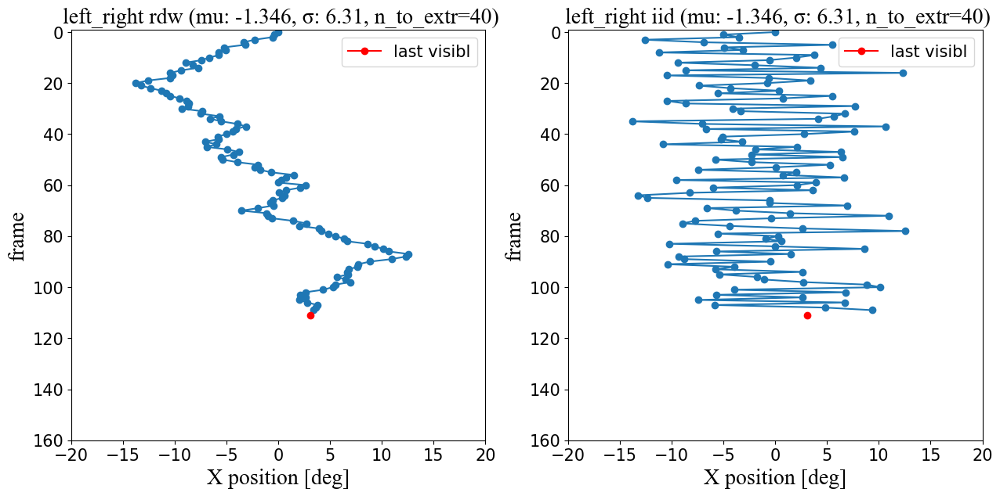

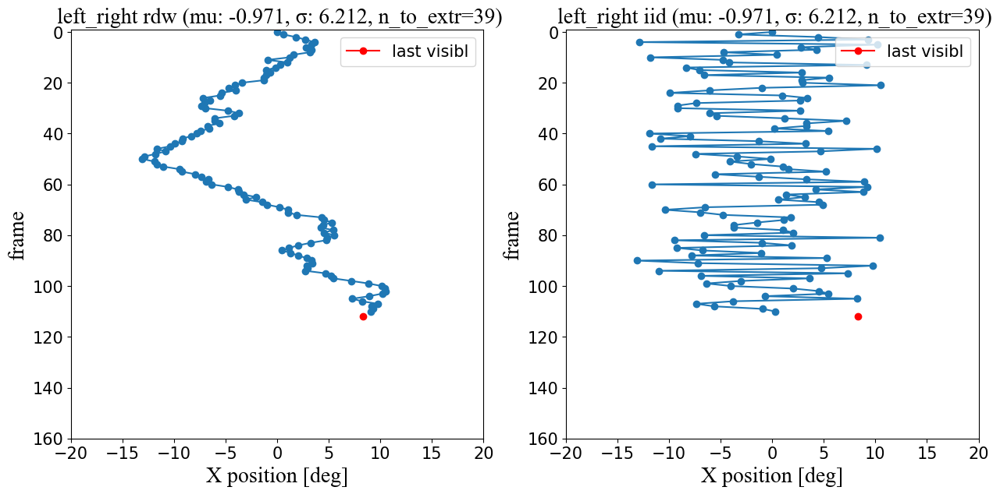

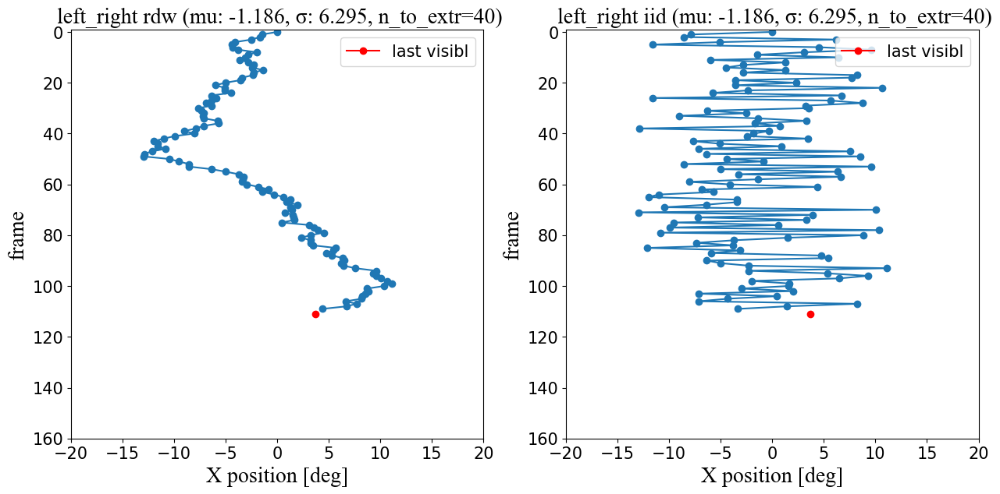

In [12]:
f_lr=check_stimul(rdw_left_right,iid_left_right,'left_right')

C:\Users\opolezh\AppData\Local\Temp\ipykernel_6340\2464156862.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(15,15))


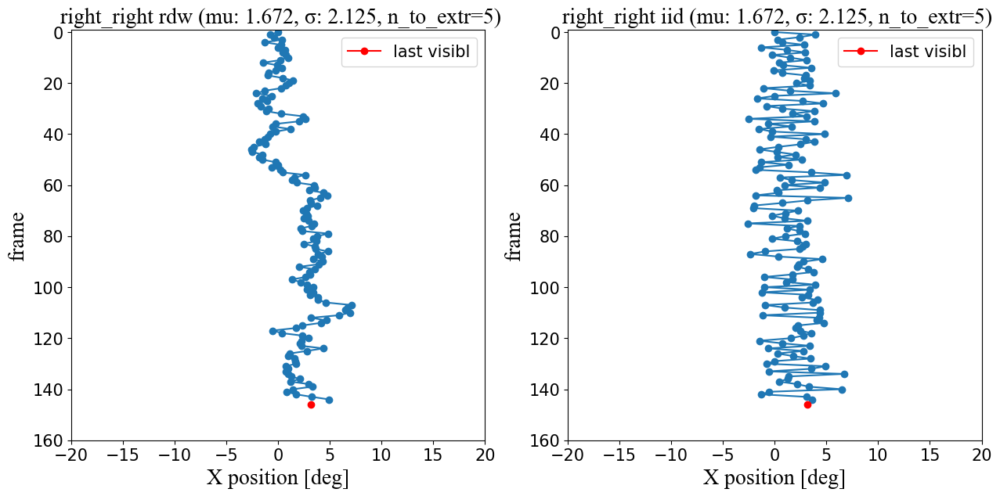

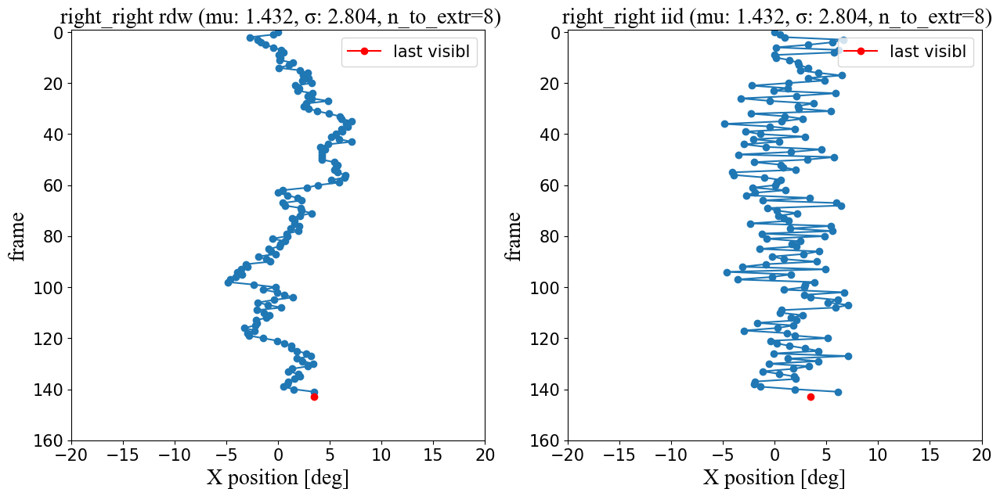

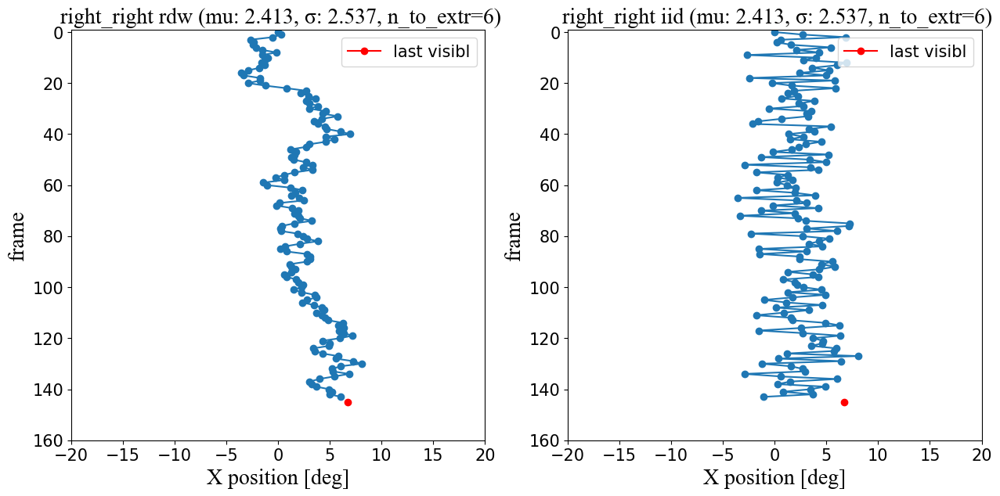

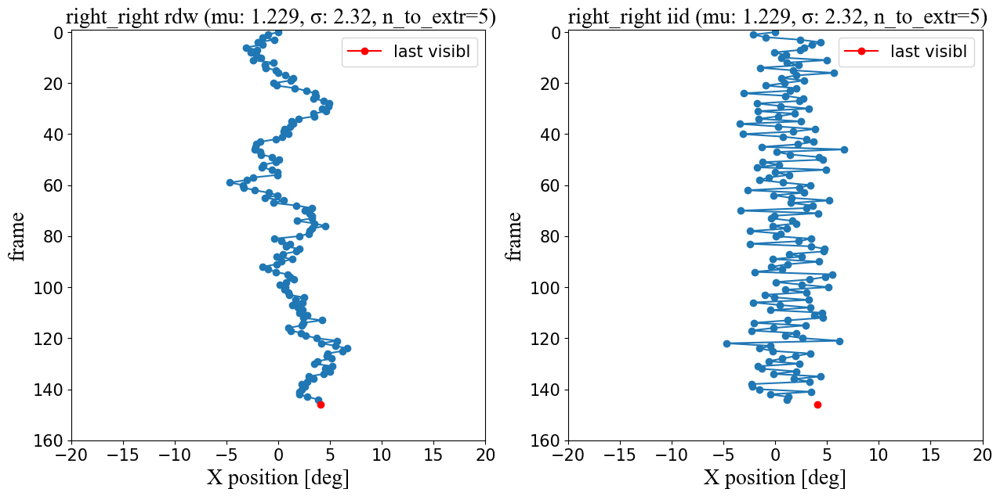

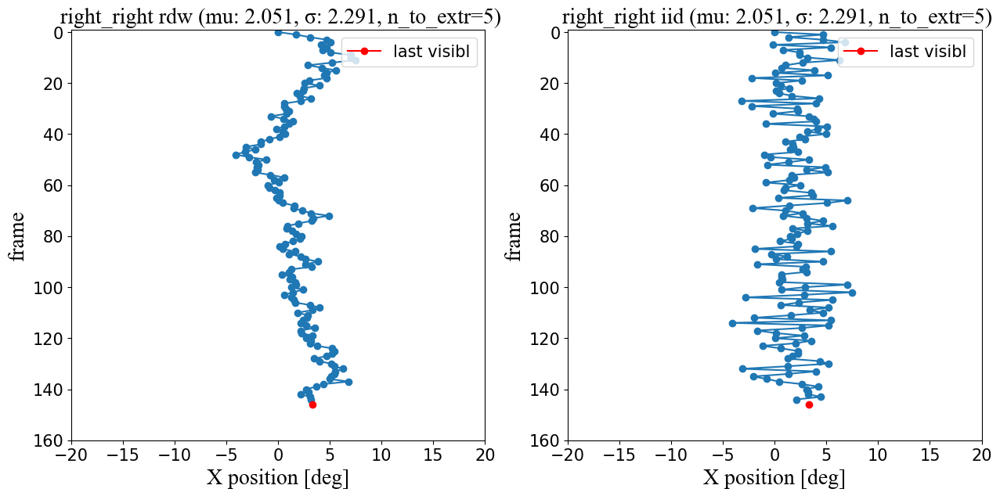

...

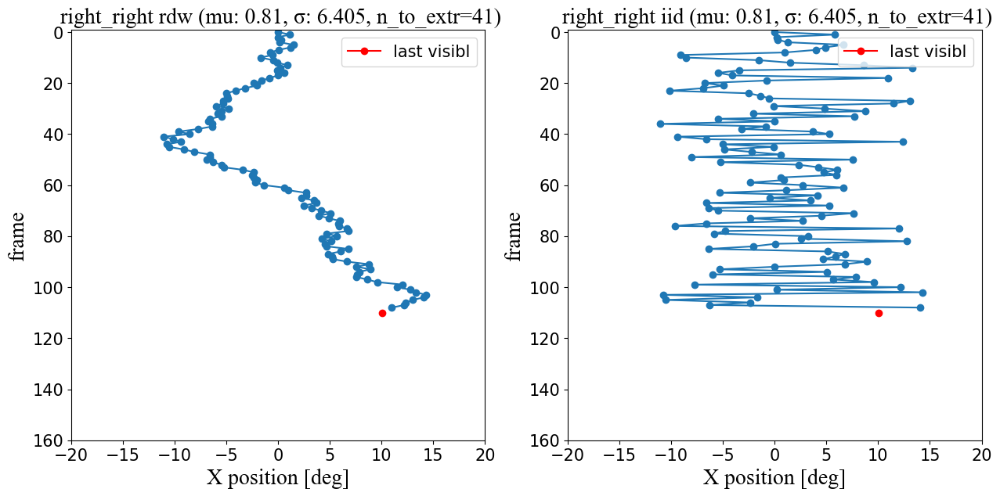

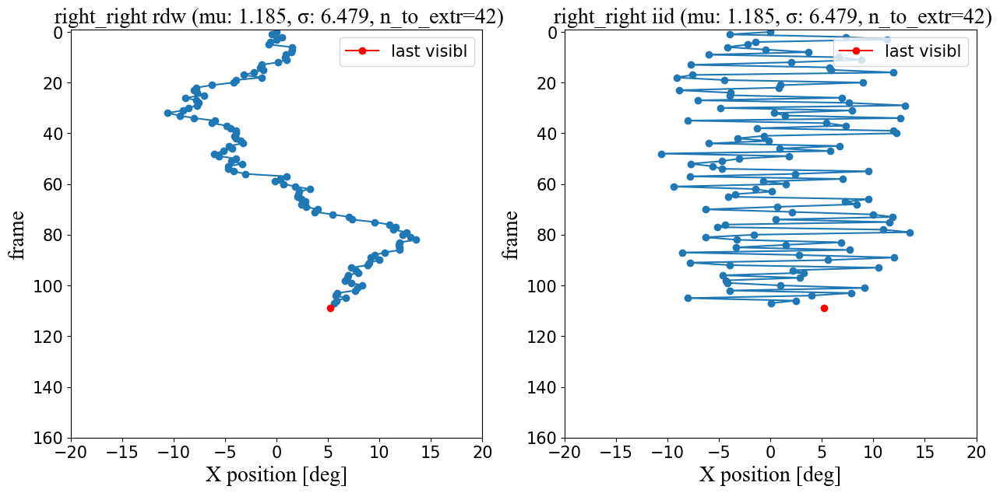

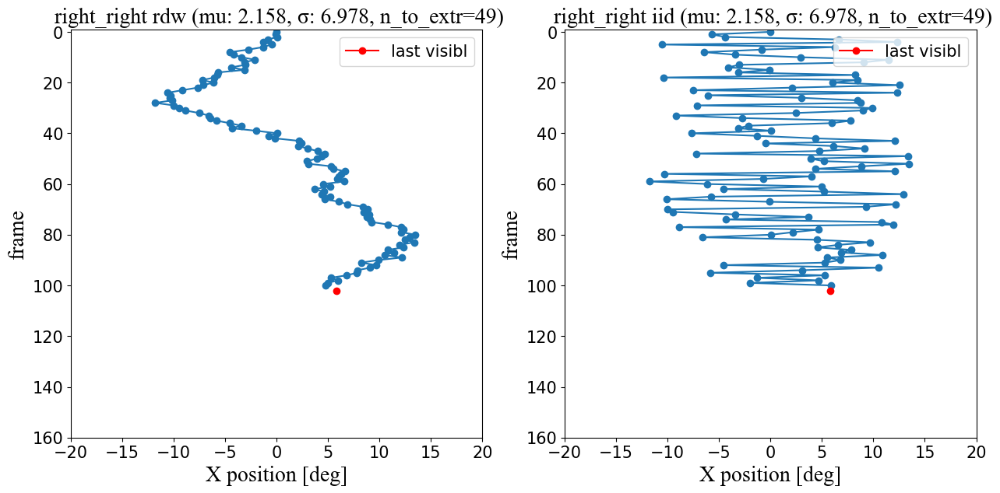

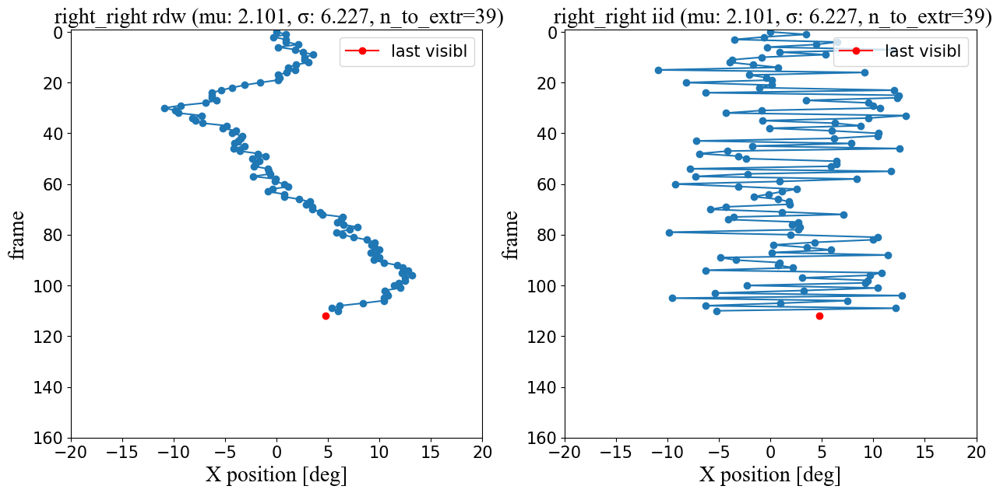

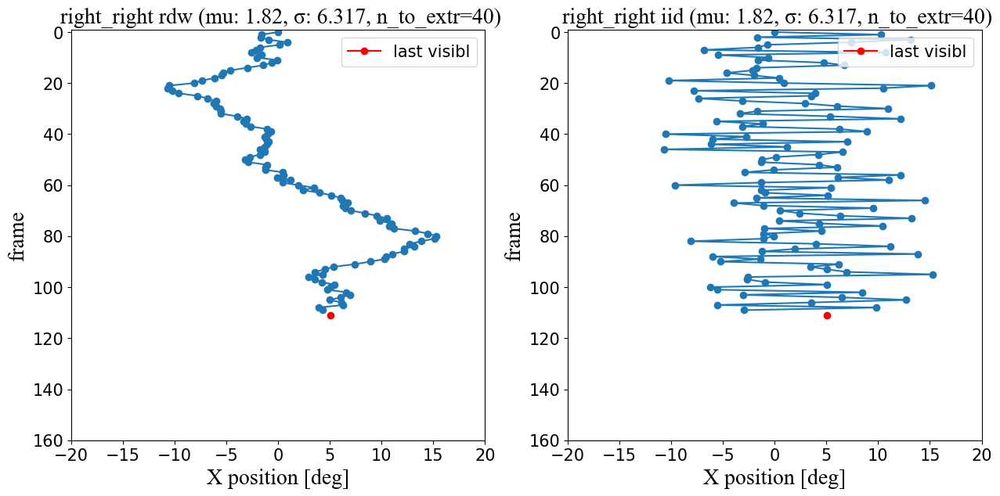

In [13]:
f_rr =check_stimul(rdw_right_right,iid_right_right,'right_right')

C:\Users\opolezh\AppData\Local\Temp\ipykernel_6340\2464156862.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(15,15))


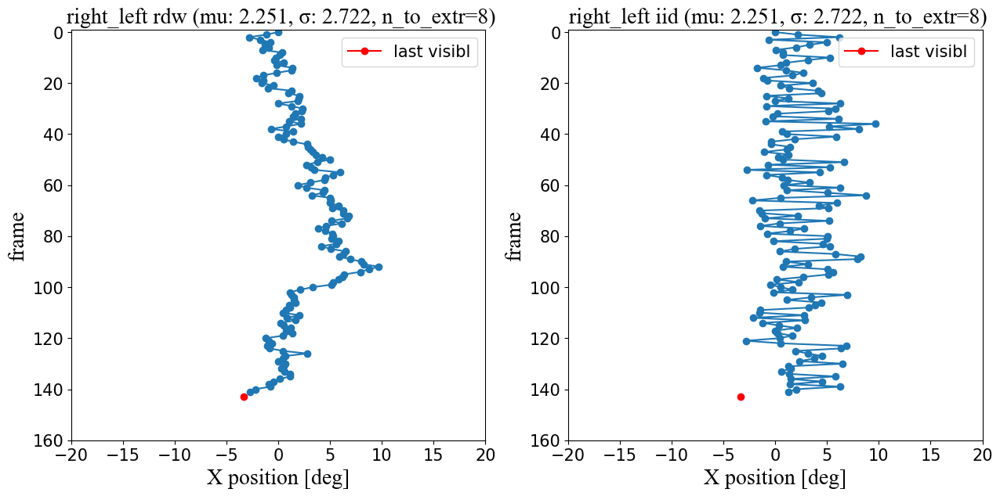

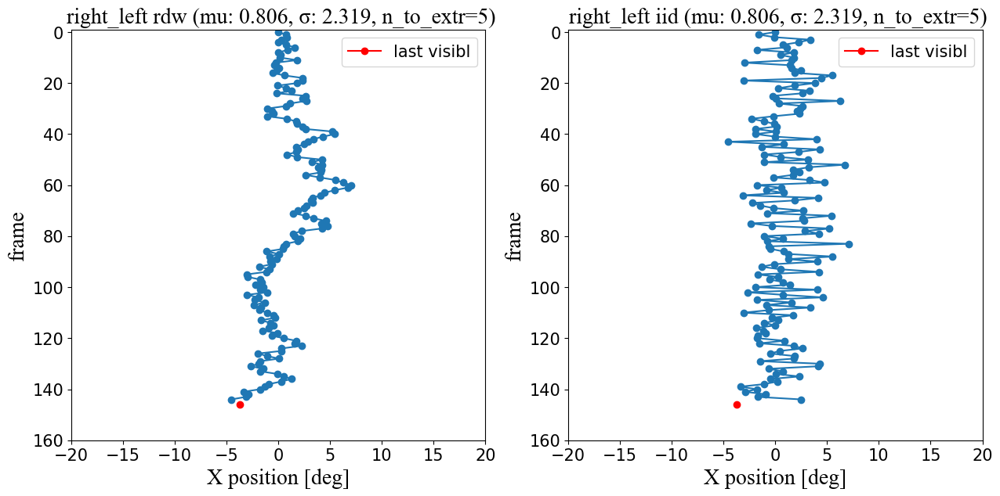

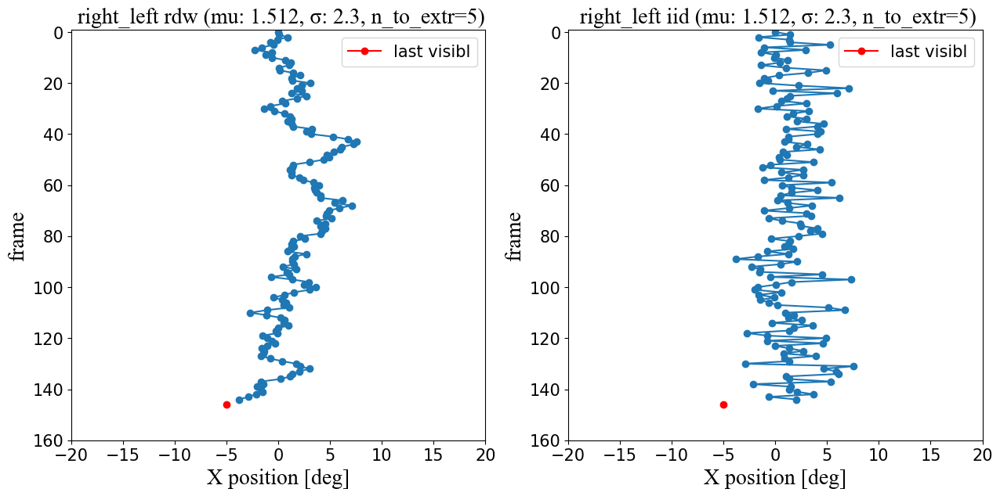

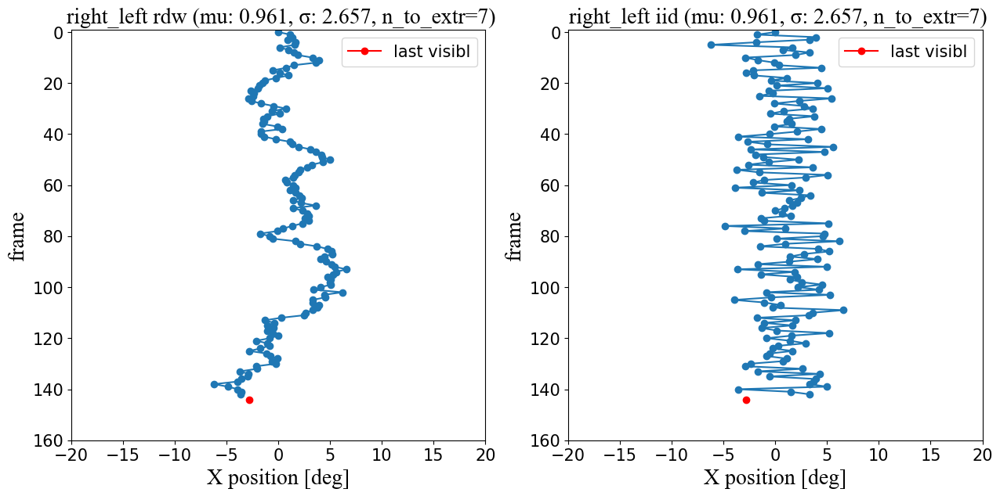

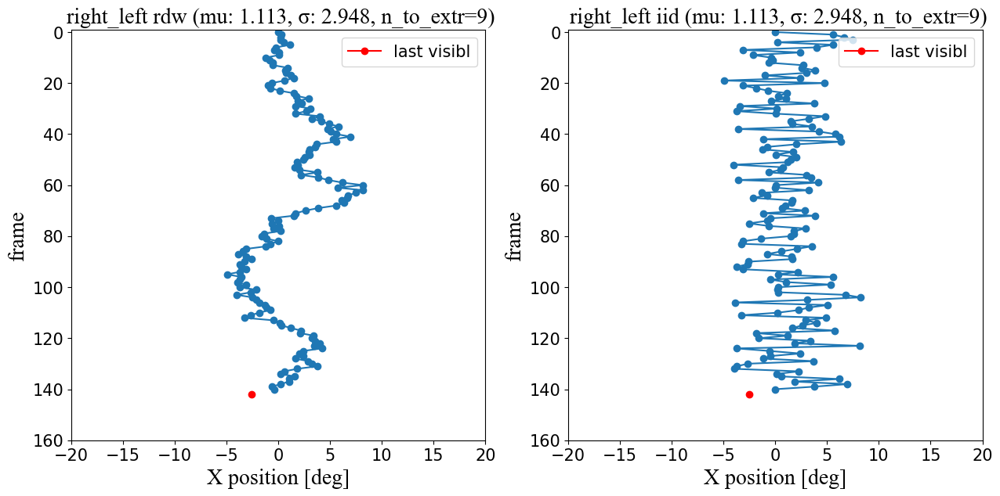

...

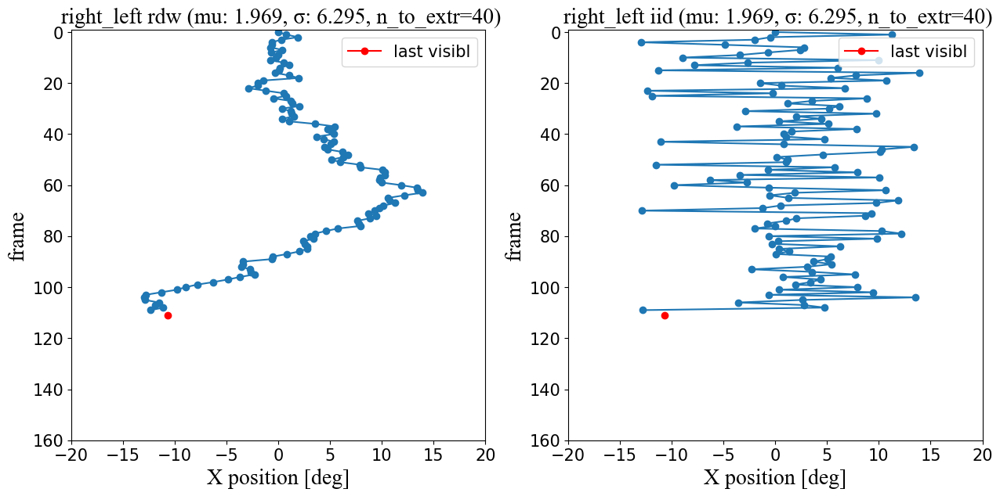

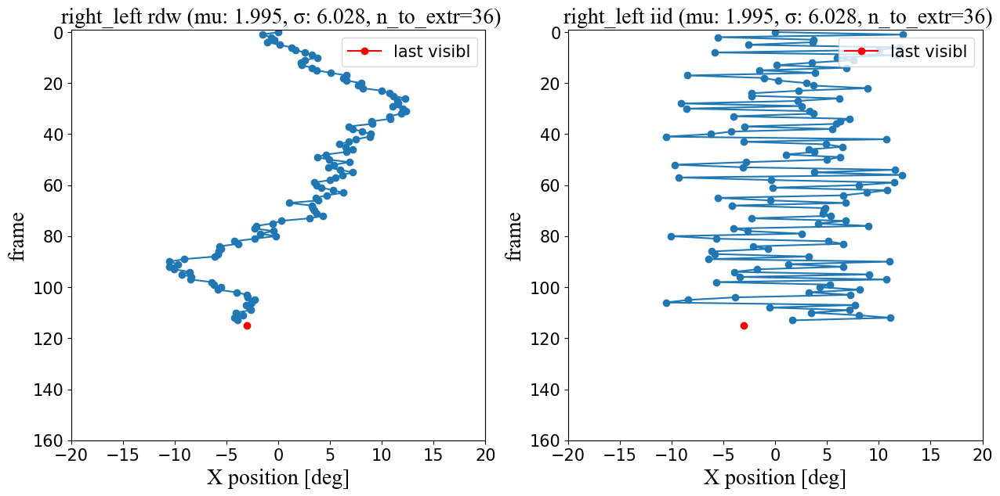

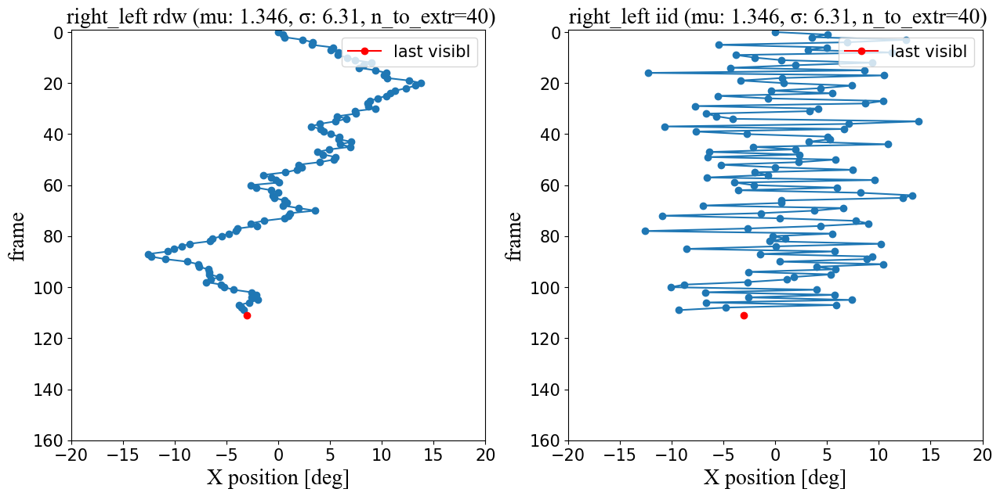

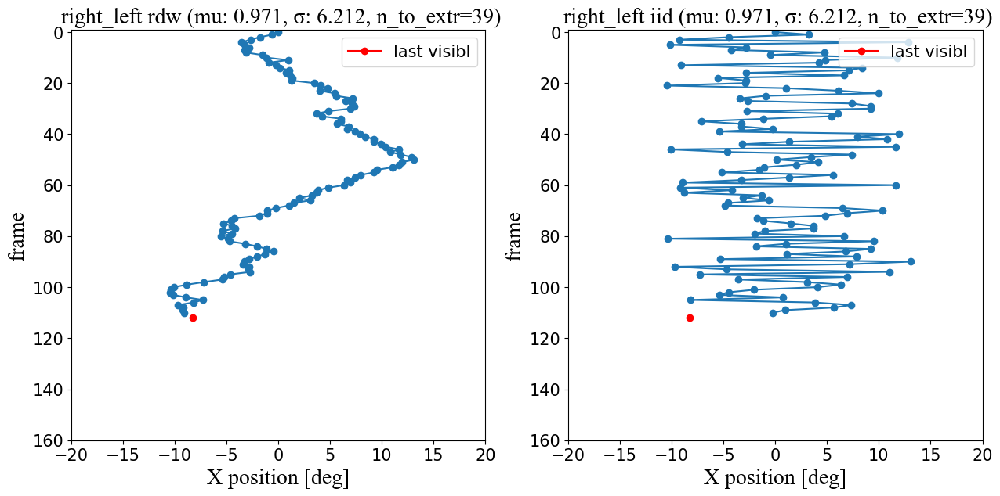

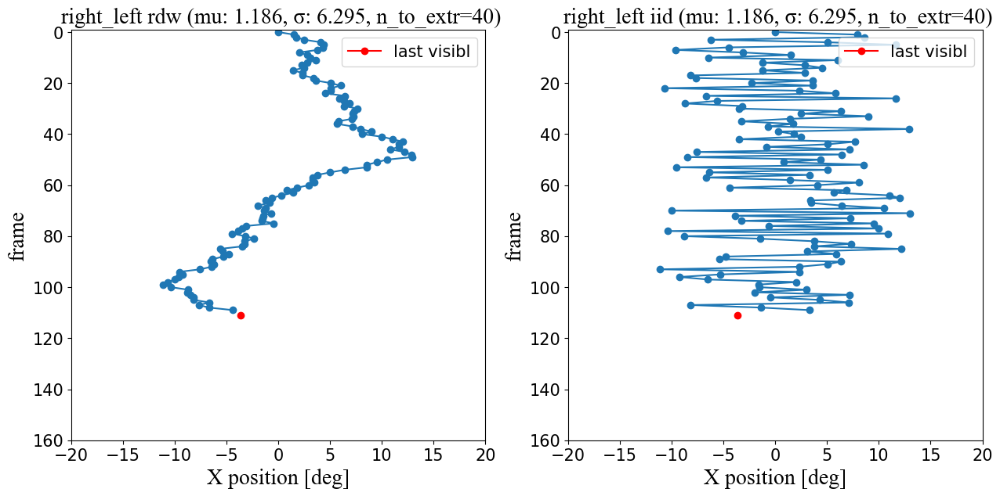

In [14]:
f_rl=check_stimul(rdw_right_left,iid_right_left,'right_left')

In [15]:
iid_csv  = stim_csv[0:4]
rdw_csv =stim_csv[4:]

In [16]:
def list_to_array(input_list):
    np_list=[]
    for elem in input_list:
        df = pd.read_csv(elem, header=None)#.fillna(0)
        np_array = df.to_numpy()
        np_list.append(np_array)
#         np_list.append(np.nan_to_num(np_array))
    return np_list

In [17]:
iid_list = list_to_array(iid_csv)
rdw_list = list_to_array(rdw_csv)

In [19]:
f_ll_rr =[]
for k in range(50):
    f= search_f(rdw_list[0][:,k])
    f_ll_rr.append(f+1)
f_lr_rl =[]
for k in range(50):
    f= search_f(rdw_list[1][:,k])
    f_lr_rl.append(f+1)

In [20]:
def data_idnex (data_list,index, f_ll_rr,f_lr_rl):
    
    index_row = np.ones((data_list[0].shape[1]),dtype=int) * index
    f_ll_rr_row = np.array(f_ll_rr)
    f_lr_rl_row = np.array(f_lr_rl)
    data_index = []
#     for elem in data_list:    
    data_index.append(np.vstack([index_row,f_ll_rr_row, data_list[0]])) # left left
    data_index.append(np.vstack([index_row,f_lr_rl_row, data_list[1]])) # left left
    data_index.append(np.vstack([index_row,f_lr_rl_row, data_list[2]])) # left left
    data_index.append(np.vstack([index_row,f_ll_rr_row, data_list[3]])) # left left
    
    big_data = np.hstack([data_index[0], data_index[1],data_index[2],data_index[3]])
    return big_data

In [21]:
big_iid = data_idnex (iid_list,2,f_ll_rr,f_lr_rl)
pd.DataFrame(big_iid)

,0,1,2,3,4,5,6,7,8,9,...,190,191,192,193,194,195,196,197,198,199
0,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,...,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000
1,5.000000,8.000000,6.000000,5.000000,5.000000,5.000000,8.000000,6.000000,4.000000,8.000000,...,37.000000,38.000000,44.000000,43.000000,38.000000,41.000000,42.000000,49.000000,39.000000,40.000000
2,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,-0.000000,-0.000000,-0.000000,-0.000000,-0.000000,-0.000000,-0.000000,-0.000000,-0.000000,-0.000000
3,-3.913510,-0.493584,-2.713829,2.106601,-4.679626,-0.054386,-3.116469,-1.289700,-0.856562,-2.758101,...,-3.301009,-4.448215,13.988962,-5.072115,0.223901,5.827428,-3.930300,-5.702914,3.462417,10.246321
4,-2.408095,-0.959239,-6.856131,0.963941,-1.321645,-3.573751,-2.262252,-3.573723,2.749072,-0.020425,...,2.906737,0.330638,2.155431,-2.291562,10.258451,0.234452,7.300648,-4.411893,-0.592362,-1.690805
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
147,-3.181633,0.000000,0.000000,-4.068533,-3.295401,-3.169343,0.000000,0.000000,1.922902,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
148,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-3.872652,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
149,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
150,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


In [31]:
np.savetxt('iid.csv', big_iid, delimiter=",")

In [22]:
big_rdw = data_idnex(rdw_list,1,f_ll_rr,f_lr_rl)

In [33]:
np.savetxt('rdw.csv', big_rdw, delimiter=",")

In [ ]:
# np.savetxt('stim_exp_1.csv', stim , delimiter=",")

In [ ]:
# np.savetxt('stim_exp_sh_1.csv', stim , delimiter=",")